Data found here https://foreverpollution.eu/map/expert-reviewed-journalism/

In [2]:
import pandas as pd
import matplotlib.pyplot as plt

df = pd.read_csv('expert_dataset.csv')
print(df.head)

<bound method NDFrame.head of               category      lat       lon  \
0      Known PFAS user  52.5041 -0.682637   
1      Known PFAS user  50.8719  6.034520   
2      Known PFAS user  50.2234  8.765600   
3      Known PFAS user  47.8586  5.347160   
4      Known PFAS user  39.4717 -0.538828   
...                ...      ...       ...   
44583            Known  51.2326  4.335670   
44584            Known  51.2302  4.337570   
44585            Known  51.3153  4.346180   
44586            Known  51.2343  4.334540   
44587            Known  51.2326  4.335070   

                                      name         city         country  \
0                                       3F        Corby  United Kingdom   
1                                       3M     Kerkrade     Netherlands   
2       3P - Performance Plastics Products       Karben         Germany   
3         3P Performance Plastics Products      Langres          France   
4      3P Productos Plásticos Performantes     Valenci

category,lat,lon,name,city,country,type,sector,source_type,source_text,source_url,details,matrix,pfos,pfoa,pfos_pfoa,pfna,pfbs,pfhxa,pfhxs,pfas_sum,date,year

In [3]:
# Display all unique values in the 'matrix' column
print(df['name'].unique())

['3F' '3M' '3P - Performance Plastics Products' ... 'F5'
 'Fratta-Gorzone VALLE Collettore ARICA' 'Scarico della Miteni']


In [4]:
# Cleaning data 
df_clean = df.drop(columns=['pfas_sum', 'source_type', 'source_url', 'details', ])

In [24]:
import plotly.express as px

# Create scatter map
fig = px.scatter_map(
    df,
    lat="lat",
    lon="lon",
    color="category",  
    hover_name="name",
    hover_data=["city", "country", "details"],
    zoom=3,
    opacity=0.3,
    height=600
)

fig.update_layout(mapbox_style="open-street-map")

fig.show()


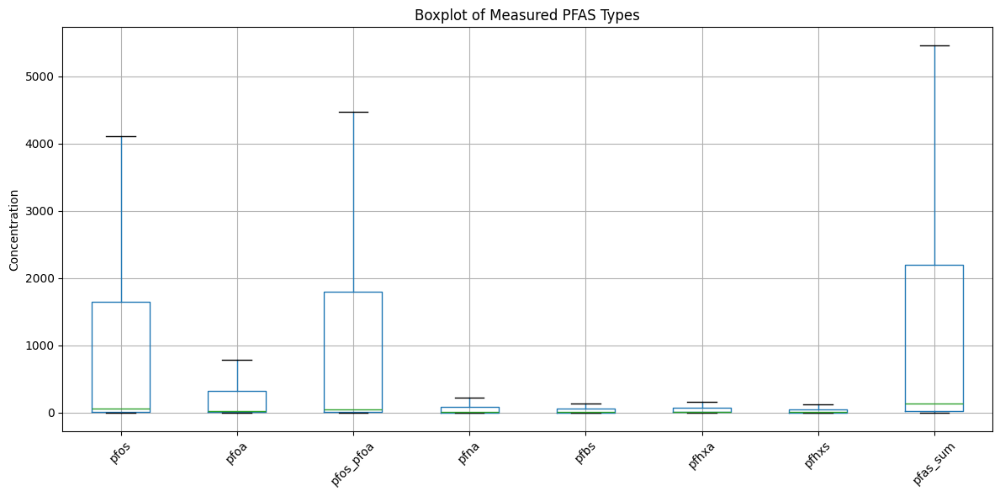

In [6]:
# Select only the columns of interest and drop rows where all are NaN
pfas_cols = ['pfos', 'pfoa', 'pfos_pfoa', 'pfna', 'pfbs', 'pfhxa', 'pfhxs', 'pfas_sum']
df_box = df[pfas_cols].dropna(how='all')

# Create a boxplot for the selected PFAS types
plt.figure(figsize=(12, 6))
df_box.boxplot(column=pfas_cols, showfliers=False)
plt.ylabel('Concentration')
plt.title('Boxplot of Measured PFAS Types')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

category,lat,lon,name,city,country,type,sector,source_type,source_text,source_url,details,matrix,pfos,pfoa,pfos_pfoa,pfna,pfbs,pfhxa,pfhxs,pfas_sum,date,year

In [7]:
summary = df_box.describe().T  
print(summary)

             count          mean            std  min        25%    50%  \
pfos       17519.0  27860.886971  696831.223091  0.0   4.970000   57.0   
pfoa       15391.0   3494.236677   81417.699698  0.0   4.000000   16.0   
pfos_pfoa  12704.0  27858.694432  602640.566268  0.0  10.000000   41.3   
pfna        3370.0    349.890179    2448.642288  0.0   0.790000    4.0   
pfbs        6357.0   4568.058172  130463.784940  0.0   2.169942   11.0   
pfhxa       9296.0    788.724586   13539.077414  0.0   2.800000   11.0   
pfhxs       6310.0  13192.387557  355280.368432  0.0   1.100000    5.2   
pfas_sum   22696.0  34383.018084  804540.616452  0.0  18.250000  140.0   

                75%         max  
pfos       1652.170  68900000.0  
pfoa        321.765   8000000.0  
pfos_pfoa  1800.000  56000000.0  
pfna         90.000     68000.0  
pfbs         56.000   7000000.0  
pfhxa        66.175    892000.0  
pfhxs        47.045  17285000.0  
pfas_sum   2195.120  72800000.0  


In [8]:
# Filter rows where pfos is exactly 68900000.0
high_pfos_places = df[df['pfos'] == 68900000.0]
print(high_pfos_places[['name', 'city', 'matrix','country', 'lat', 'lon', 'pfos']])

      name         city       matrix  country      lat      lon        pfos
44586   3M  Zwijndrecht  Groundwater  Belgium  51.2343  4.33454  68900000.0


In [9]:
print(df['category'].unique())

['Known PFAS user' 'Presumptive' 'Known']


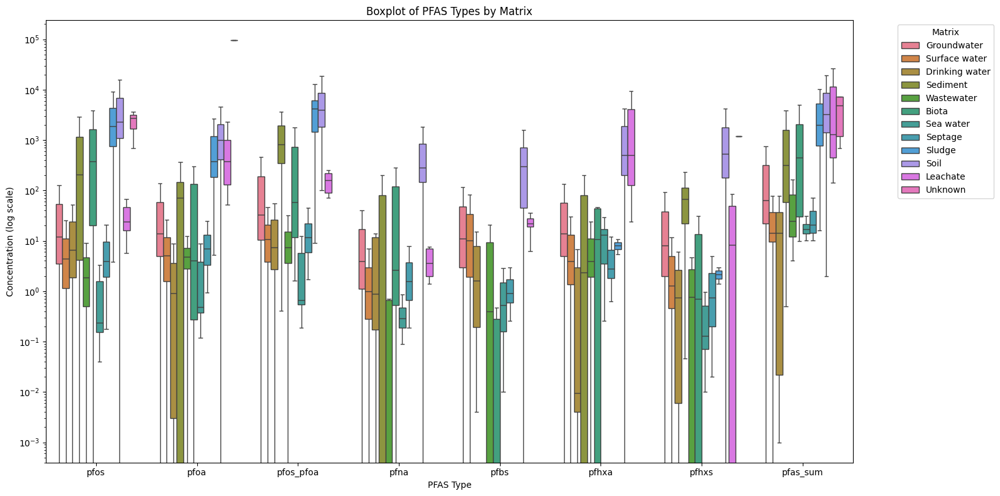

In [10]:
import seaborn as sns

# Create a boxplot for each PFAS type, grouped by unique 'matrix' values
plt.figure(figsize=(16, 8))
df_melt = df.melt(id_vars='matrix', value_vars=pfas_cols, var_name='PFAS Type', value_name='Concentration')
df_melt = df_melt.dropna(subset=['Concentration', 'matrix'])

sns.boxplot(data=df_melt, x='PFAS Type', y='Concentration', hue='matrix', showfliers=False)
plt.yscale('log')
plt.title('Boxplot of PFAS Types by Matrix')
plt.ylabel('Concentration (log scale)')
plt.xlabel('PFAS Type')
plt.legend(title='Matrix', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

In [11]:
# Display all unique values in the 'matrix' column
print(df['matrix'].unique())

[nan 'Drinking water' 'Wastewater' 'Unknown' 'Groundwater' 'Soil'
 'Surface water' 'Sediment' 'Biota' 'Sea water' 'Septage' 'Sludge'
 'Leachate']


In [ ]:
# setting up the data
from sklearn.neighbors import KNeighborsRegressor
import numpy as np
import pandas as pd

# Columns to estimate
pfas_cols = ['pfos', 'pfoa', 'pfos_pfoa', 'pfna', 'pfbs', 'pfhxa', 'pfhxs']

# Choose matrix type
selected_matrix = "Groundwater"  
# Choose cordinate set
your_lat = 55.3177
your_lon = 10.60080


# Filter by matrix and drop rows missing required values
df_valid = df_clean[
    (df['matrix'] == selected_matrix)
].dropna(subset=['lat', 'lon'] + pfas_cols, how='any')

# Features: latitude and longitude
X = df_valid[['lat', 'lon']].values

# Targets: multiple PFAS columns
y = df_valid[pfas_cols].values



In [25]:
# Fit multi-output k-NN regressor
knn = KNeighborsRegressor(n_neighbors=1, weights='distance')
knn.fit(X, y)

# Example: predict PFAS values at a new location
new_coords = np.array([[your_lat, your_lon]])
predicted = knn.predict(new_coords)

# Convert prediction to DataFrame for readability
predicted_df = pd.DataFrame(predicted, columns=pfas_cols)
print(f"Matrix type: {selected_matrix}")
print(predicted_df.round(2))

Matrix type: Groundwater
   pfos  pfoa  pfos_pfoa  pfna  pfbs  pfhxa  pfhxs
0  74.0  17.0       91.0   1.1   1.8   48.0   36.0


In [14]:
from sklearn.ensemble import RandomForestRegressor

# Fit multi-output RandomForest regressor
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X, y)

# Predict PFAS values at the new location
rf_predicted = rf.predict(new_coords)

# Convert prediction to DataFrame for readability
rf_predicted_df = pd.DataFrame(rf_predicted, columns=pfas_cols)
print("RandomForestRegressor predictions for your coordinates:")
print(rf_predicted_df.round(2))

RandomForestRegressor predictions for your coordinates:
    pfos   pfoa  pfos_pfoa  pfna  pfbs  pfhxa  pfhxs
0  63.27  46.89     110.16  1.67  7.81  67.37  42.13


In [15]:
from scipy.spatial import distance
# Extract your coordinates


# Compute distances to all measured locations
coords = df_valid[['lat', 'lon']].values
dists = distance.cdist([[your_lat, your_lon]], coords)
closest_idx = dists.argmin()

# Get the closest measured location and its PFAS values
closest_row = df_valid.iloc[closest_idx]
print("Closest measured location:")
print(closest_row[['lat', 'lon', 'matrix', 'name', 'city', 'country'] + pfas_cols])
print(f"Distance to your coordinates: {dists[0, closest_idx]:.4f} degrees")

Closest measured location:
lat              55.3994
lon              10.4236
matrix       Groundwater
name                 NaN
city           Odense NØ
country          Denmark
pfos                74.0
pfoa                17.0
pfos_pfoa           91.0
pfna                 1.1
pfbs                 1.8
pfhxa               48.0
pfhxs               36.0
Name: 34705, dtype: object
Distance to your coordinates: 0.1951 degrees


In [16]:
# Replace 'x' with your desired matrix type, e.g., 'Groundwater' or 'Drinking water'
matrix_type = 'Groundwater'
country = 'Denmark'
locations = df[(df['matrix'] == matrix_type) & (df['country'] == country)][['city', 'lat', 'lon', 'type']]
print(locations)

                 city      lat       lon               type
23865  Ferritslev Fyn  55.3177  10.60080  Sampling location
23871         Rødding  55.3582   9.20077  Sampling location
23872    Augustenborg  54.9454   9.87421  Sampling location
23877       Haderslev  55.2514   9.50118  Sampling location
23881          Lemvig  56.5187   8.32145  Sampling location
...               ...      ...       ...                ...
44132      Copenhagen  55.6779  12.63060  Sampling location
44173        Odense N  55.4730  10.31630  Sampling location
44242      Sønderborg  54.9691   9.78698  Sampling location
44267      Sønderborg  54.9692   9.78697  Sampling location
44337      Sønderborg  54.9692   9.78677  Sampling location

[1879 rows x 4 columns]


In [17]:
# NN starts here

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# Assume X, y from your previous step
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
X_val,   X_test, y_val,   y_test   = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

scaler = StandardScaler().fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_val_scaled   = scaler.transform(X_val)
X_test_scaled  = scaler.transform(X_test)

In [28]:
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks, regularizers

n_outputs = y_train.shape[1]   # number of PFAS columns

model = models.Sequential([
    layers.Input(shape=(X_train_scaled.shape[1],)),
    layers.Dense(512, activation='relu', kernel_regularizer=regularizers.l2(1e-4)),
    layers.BatchNormalization(),
    layers.Dropout(0.3),
    layers.Dense(256, activation='relu', kernel_regularizer=regularizers.l2(1e-4)),
    layers.BatchNormalization(),
    layers.Dropout(0.3),
    layers.Dense(256, activation='relu', kernel_regularizer=regularizers.l2(1e-4)),
    layers.BatchNormalization(),
    layers.Dropout(0.2),
    layers.Dense(256, activation='relu', kernel_regularizer=regularizers.l2(1e-4)),
    layers.Dense(n_outputs, activation='linear')
])

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
    loss='mse',
    metrics=['mae']
)

es = callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

history = model.fit(
    X_train_scaled, y_train,
    validation_data=(X_val_scaled, y_val),
    batch_size=32,
    epochs=200,
    callbacks=[es],
    verbose=2
)


Epoch 1/200
17/17 - 4s - 211ms/step - loss: 91003728.0000 - mae: 1625.6001 - val_loss: 43872168.0000 - val_mae: 1318.2736
Epoch 2/200
17/17 - 0s - 11ms/step - loss: 90967968.0000 - mae: 1622.4137 - val_loss: 43860508.0000 - val_mae: 1315.9684
Epoch 3/200
17/17 - 0s - 11ms/step - loss: 90892000.0000 - mae: 1617.7595 - val_loss: 43814684.0000 - val_mae: 1310.3740
Epoch 4/200
17/17 - 0s - 11ms/step - loss: 90682312.0000 - mae: 1613.8766 - val_loss: 43700744.0000 - val_mae: 1304.9553
Epoch 5/200
17/17 - 0s - 12ms/step - loss: 90371184.0000 - mae: 1615.6215 - val_loss: 43535676.0000 - val_mae: 1307.9769
Epoch 6/200
17/17 - 0s - 11ms/step - loss: 89855728.0000 - mae: 1624.9762 - val_loss: 43324520.0000 - val_mae: 1312.9114
Epoch 7/200
17/17 - 0s - 12ms/step - loss: 89350104.0000 - mae: 1655.9192 - val_loss: 43211044.0000 - val_mae: 1314.0140
Epoch 8/200
17/17 - 0s - 11ms/step - loss: 88756272.0000 - mae: 1689.7430 - val_loss: 42980404.0000 - val_mae: 1320.9062
Epoch 9/200
17/17 - 0s - 11ms/s

In [19]:
# Evaluate
val_loss, val_mae = model.evaluate(X_test_scaled, y_test, verbose=0)
print(f"Test MAE: {val_mae:.3f}")

# Predict
new_scaled = scaler.transform(new_coords)  
preds_nn  = model.predict(new_scaled)

import pandas as pd
pd.DataFrame(preds_nn, columns=pfas_cols).round(2)


Test MAE: 3040.047
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


,pfos,pfoa,pfos_pfoa,pfna,pfbs,pfhxa,pfhxs
0,0.19,0.1,0.29,0.33,-0.04,0.13,0.1


In [31]:
from scipy.spatial import distance
# Extract your coordinates


# Compute distances to all measured locations
coords = df_valid[['lat', 'lon']].values
dists = distance.cdist([[your_lat, your_lon]], coords)
closest_idx = dists.argmin()

# Get the closest measured location and its PFAS values
closest_row = df_valid.iloc[closest_idx]
print("Closest measured location:")
print(closest_row[['lat', 'lon', 'matrix', 'name', 'city', 'country'] + pfas_cols])
print(f"Distance to your coordinates: {dists[0, closest_idx]:.4f} degrees")

Closest measured location:
lat              55.3994
lon              10.4236
matrix       Groundwater
name                 NaN
city           Odense NØ
country          Denmark
pfos                74.0
pfoa                17.0
pfos_pfoa           91.0
pfna                 1.1
pfbs                 1.8
pfhxa               48.0
pfhxs               36.0
Name: 34705, dtype: object
Distance to your coordinates: 0.1951 degrees


In [21]:
print(df_valid.head())

      category      lat       lon                          name        city  \
22589    Known  50.6007   3.87619                 BRUGELETTE P1  BRUGELETTE   
22963    Known  50.6048   3.80565                        MAFFLE         ATH   
24421    Known  56.6437   9.79059                           NaN       Hobro   
24545    Known  52.0800  -2.60362  SHUCKNALL SPRING NR HEREFORD    Yarkhill   
24626    Known  57.4598  10.01670                           NaN    Hjørring   

              country               type sector  \
22589         Belgium  Sampling location    NaN   
22963         Belgium  Sampling location    NaN   
24421         Denmark  Sampling location    NaN   
24545  United Kingdom  Sampling location    NaN   
24626         Denmark  Sampling location    NaN   

                            source_text       matrix  pfos  pfoa  pfos_pfoa  \
22589  Service public de Wallonie (SPW)  Groundwater  0.00  0.00       0.00   
22963  Service public de Wallonie (SPW)  Groundwater  0.00  